# SUS-1R (low alloyed steel)

This notebook contains the results for the dataset SUS-1R:

### Chapters:
 - Baseline Regression
 - Baseline Simulation

#### Source Directory

In [5]:
sdir = r'..\data\raw data txt\SUS-1R'

#### Imports

In [3]:
import os, sys
if os.path.dirname(os.getcwd()) not in sys.path:
    sys.path.insert(0, os.path.dirname(os.getcwd())) # appends parent directory to syspath -> enables import of src

import lib.datalayers as dly
import lib.model as mod
import importlib
importlib.reload(mod)
importlib.reload(dly)

<module 'lib.datalayers' from 'c:\\Users\\Marlene\\Nextcloud\\DOKUMENTE\\Universität\\Diplomarbeit\\lib\\datalayers.py'>

#### Initialize dataset

In [7]:
dataset = dly.Dataset(sdir,overwrite=False)

Dataset: SUS-1R
Files of dataset loaded


## Baseline Regression

The best settings for baseline regression were:
- minima filter width = 40 nm
- detailed region for minima filter at start and end of spectrum = 20 nm
- steps of minima filter within detailed region = 40/2/10
- minima filter in both directions = True
- endpoint weight = 10000

The median common degree was 3.

Calculate plot: 100%|██████████| 15/15 [03:13<00:00, 12.92s/it]


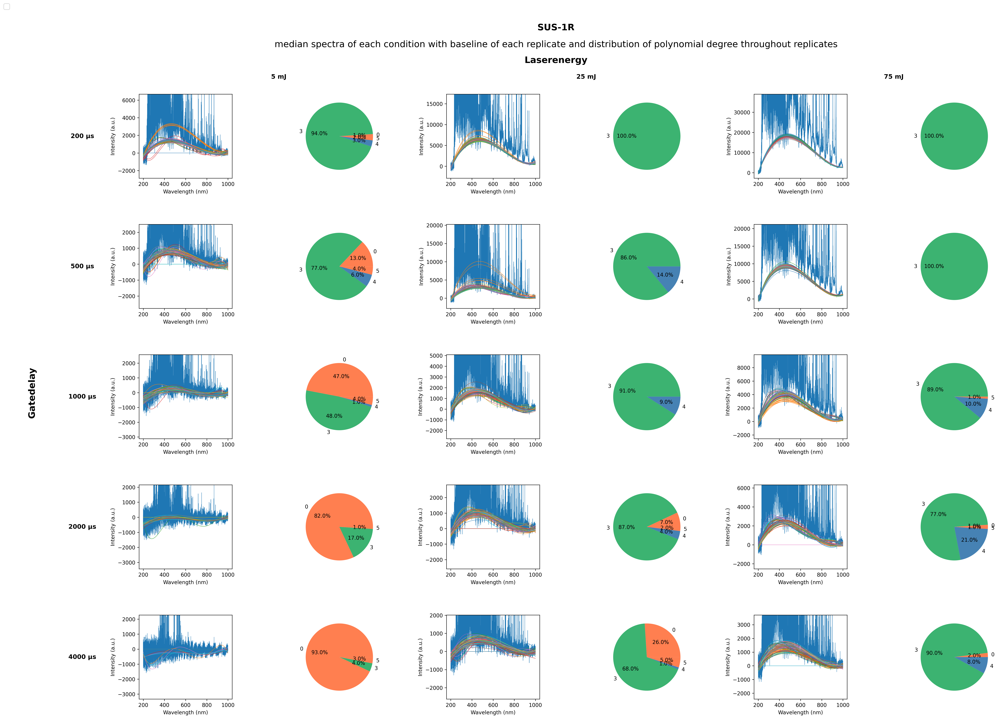

In [5]:
dataset.plot_dataset(type_list=["stability", "pie"], width_wvn_detail=20, detailfactor=10, endpoint_weight=10000, deg_min=3, reverse=True)

Calculate plot: 100%|██████████| 15/15 [00:40<00:00,  2.68s/it]


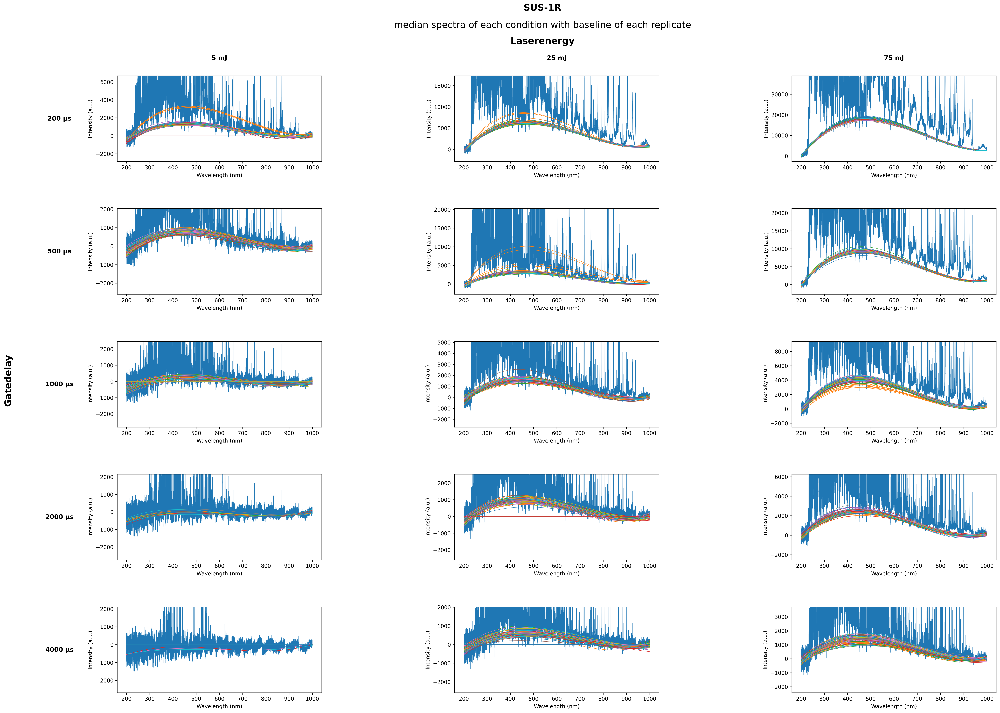

In [13]:
dataset.plot_dataset(type_list=["stability"], width_wvn_detail=20, detailfactor=10, endpoint_weight=10000, deg_min=3, deg_max=3)

Calculate plot: 100%|██████████| 15/15 [01:06<00:00,  4.41s/it]


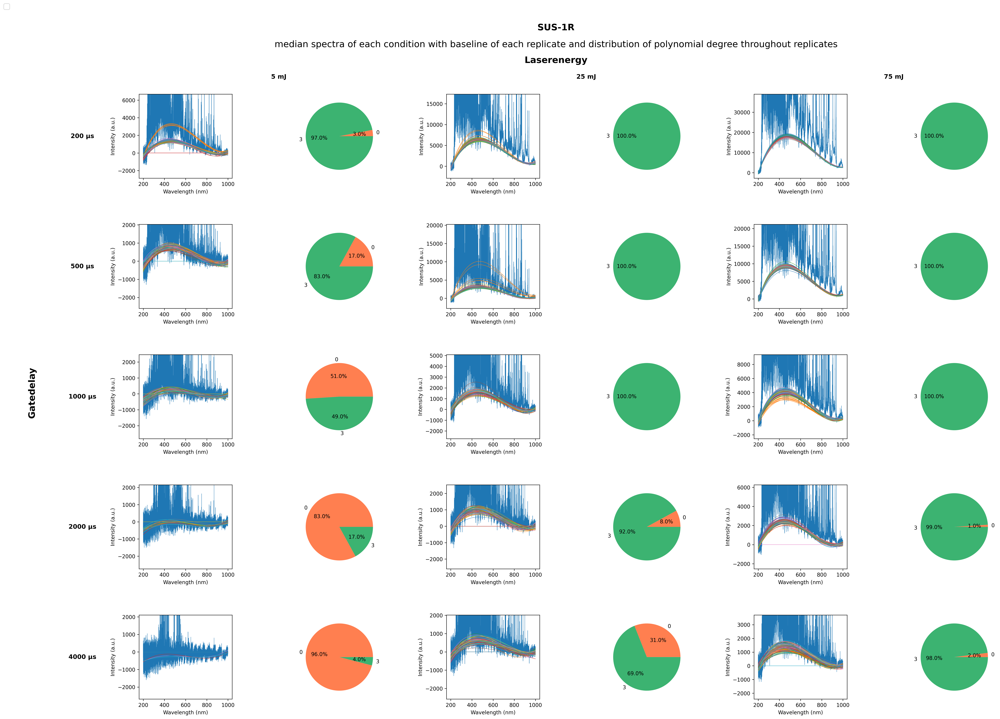

In [5]:
dataset.plot_dataset(type_list=["stability","pie"],  width_wvn_detail=20, detailfactor=10, endpoint_weight=10000, deg_min=3, deg_max=3)

Using 4 as a common degree did not work out well. For one condition, no fit at all was possible and the baselines for spectrums with low signals were very wobbly.

Calculate plot: 100%|██████████| 15/15 [01:05<00:00,  4.35s/it]


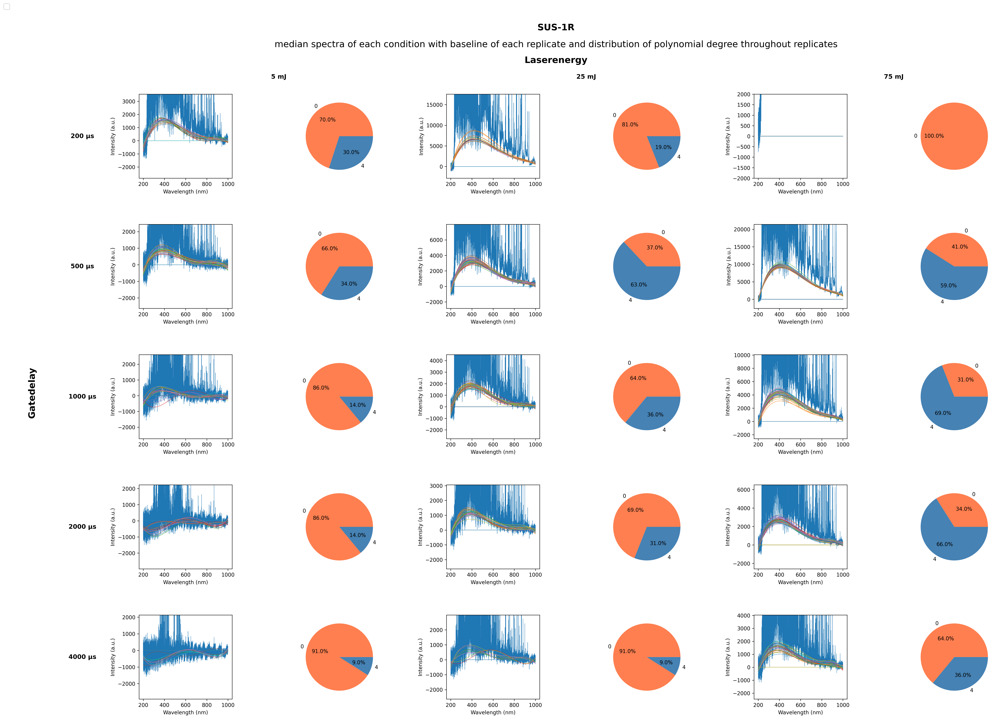

In [6]:
dataset.plot_dataset(type_list=["stability","pie"], deg_min=4, deg_max=4)

## Baseline Simulation

Fit model: 100%|██████████| 4/4 [00:00<00:00,  9.92it/s]


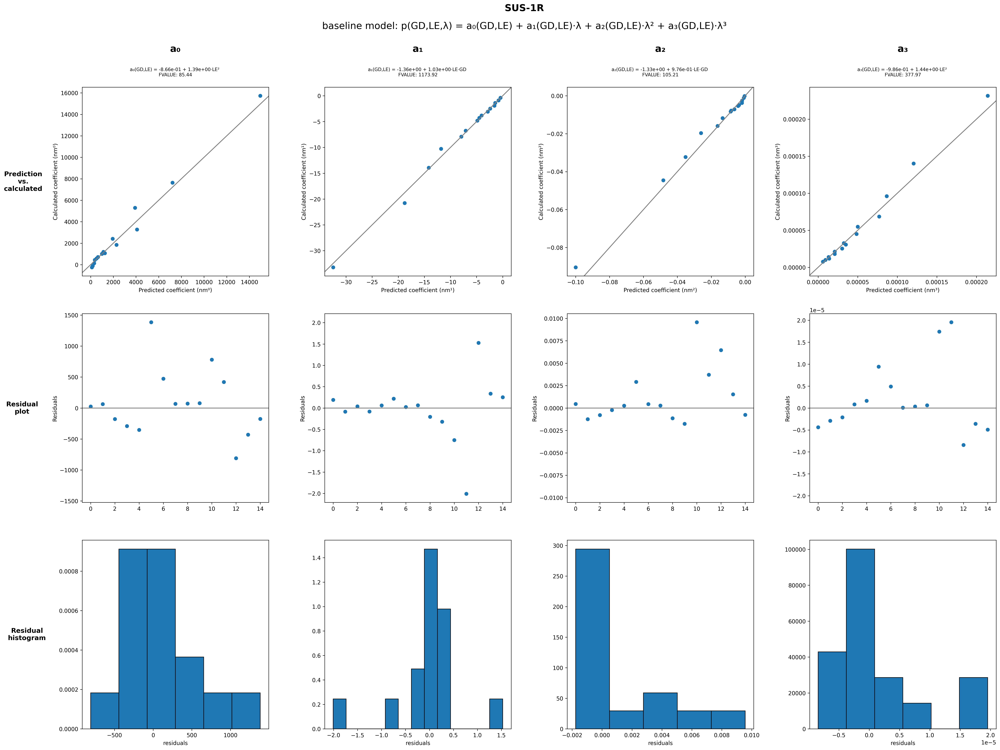

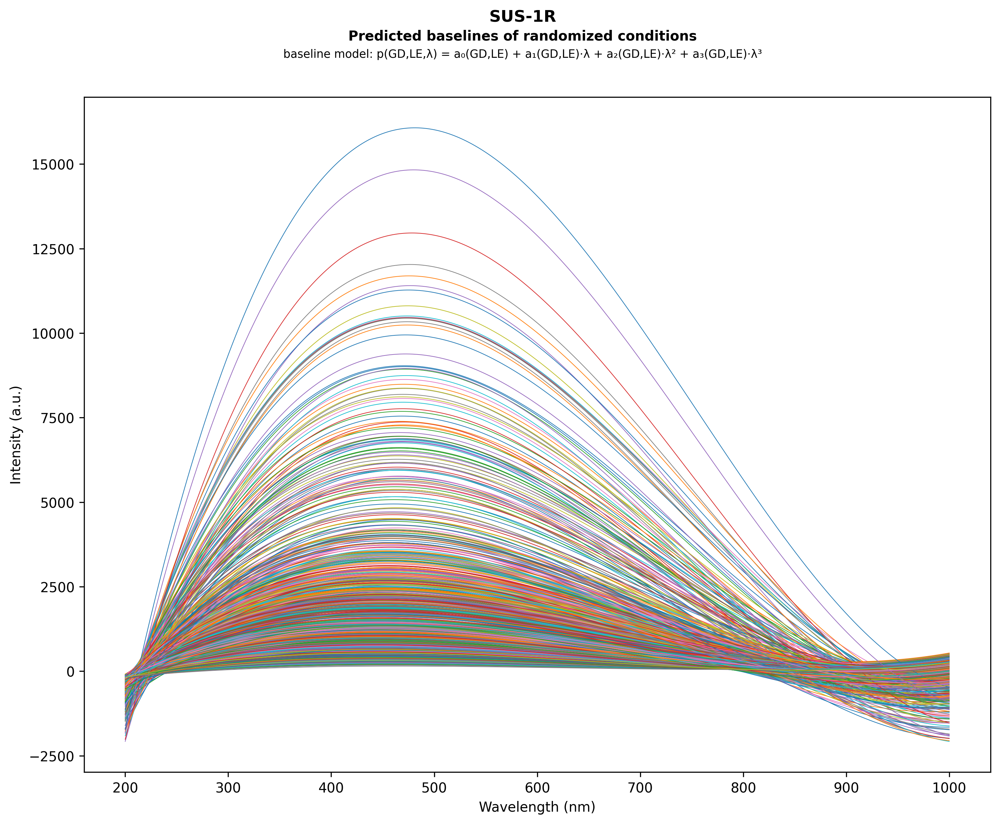

In [6]:
summary_baseline_coeff_regression, baseline_regression_settings =dataset.summarize_baseline_coefficients(width_wvn_detail=20, detailfactor=10, endpoint_weight=10000, deg_min=3, deg_max=3, overwrite=False)
baseline = mod.Baseline(dataset.name, summary_baseline_coeff_regression, baseline_regression_settings, median=True)
baseline_model = baseline.model.fit(transform_x=True, transform_y=True)
baseline.summary_coeff_models()
baseline.model_assessment_plot()
baseline.model_stabilty_plot(dataset.wavelength_range)

The simulated baseline fits very good for the majority of the given conditions and looks very stable in the stability plot. The slight offset for the condition of LE=25 mJ and GD=200 µs is acceptable since the shape of the baseline fits to the calculated lines.

Calculate plot: 100%|██████████| 15/15 [00:43<00:00,  2.89s/it]


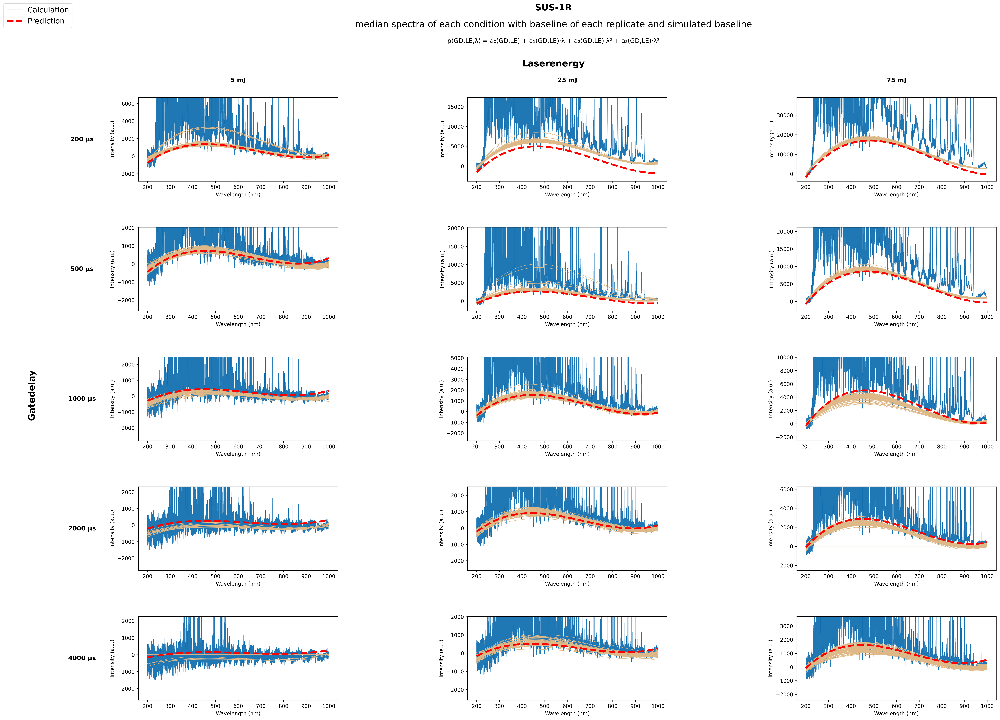

In [10]:
dataset.plot_dataset(type_list=["stability"], baseline_regression=True, baseline_model=baseline_model, width_wvn_detail=20, detailfactor=10, endpoint_weight=10000, deg_min=3, deg_max=3)